In [1]:
from pycaret.datasets import get_data
dataset = get_data('credit', profile=True)

Summarize dataset:   0%|          | 0/37 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [2]:
data = dataset.sample(frac=0.95, random_state=786)
data_unseen = dataset.drop(data.index)

data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions ' + str(data_unseen.shape))

Data for Modeling: (22800, 24)
Unseen Data For Predictions (1200, 24)


In [3]:
from pycaret.classification import *

In [4]:
exp_clf102 = setup(data = data, target = 'default', session_id=1,
                  normalize = True, 
                  transformation = True, 
                  ignore_low_variance = True,
                  remove_multicollinearity = True, multicollinearity_threshold = 0.95,
                  bin_numeric_features = ['LIMIT_BAL', 'AGE'],
                  group_features = [['BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'],
                                   ['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']],
                  log_experiment = True, experiment_name = 'credit1')

,Description,Value
0,session_id,1
1,Target,default
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(22800, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


In [5]:
top3 = compare_models(n_select = 3)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.8212,0.0000,0.3486,0.6871,0.4618,0.3683,0.3991,0.0380
lda,Linear Discriminant Analysis,0.8206,0.7724,0.3699,0.6693,0.4757,0.3783,0.4029,0.1580
catboost,CatBoost Classifier,0.8196,0.7738,0.3631,0.6683,0.4695,0.3723,0.3980,3.5360
ada,Ada Boost Classifier,0.8193,0.7688,0.3304,0.6886,0.4458,0.3536,0.3880,0.4800
gbc,Gradient Boosting Classifier,0.8193,0.7741,0.3514,0.6742,0.4611,0.3655,0.3939,2.0330
lightgbm,Light Gradient Boosting Machine,0.8182,0.7715,0.3568,0.6636,0.4632,0.3657,0.3916,0.7380
rf,Random Forest Classifier,0.8148,0.7578,0.3491,0.6498,0.4535,0.3542,0.3793,0.7830
et,Extra Trees Classifier,0.8110,0.7507,0.3562,0.6265,0.4535,0.3497,0.3704,0.6680
xgboost,Extreme Gradient Boosting,0.8094,0.7489,0.3474,0.6226,0.4453,0.3413,0.3628,2.9430
qda,Quadratic Discriminant Analysis,0.7871,0.7347,0.1009,0.6042,0.1723,0.1169,0.1803,0.1110


In [7]:
print(top3)

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=1, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), <catboost.core.CatBoostClassifier object at 0x10b5e0750>]


In [ ]:
lda = create_model('lda', fold = 5, round = 4)

In [29]:
tuned_lda = tune_model(lda, optimize = 'recall') #takes time

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8283,0.7875,0.4176,0.6806,0.5176,0.4204,0.4389
1,0.8164,0.7698,0.3494,0.6578,0.4564,0.3582,0.3841
2,0.8139,0.7507,0.2983,0.6774,0.4142,0.3229,0.3614
3,0.8208,0.7817,0.3864,0.6602,0.4875,0.3878,0.4082
4,0.8289,0.7909,0.4119,0.6872,0.5151,0.4191,0.4393
5,0.8177,0.7740,0.3494,0.6649,0.4581,0.3610,0.3880
6,0.8127,0.7317,0.3494,0.6373,0.4514,0.3498,0.3728
7,0.8271,0.7765,0.4915,0.6407,0.5563,0.4512,0.4573
8,0.8076,0.7834,0.4602,0.5806,0.5135,0.3956,0.3997
9,0.8219,0.7558,0.3693,0.6771,0.4779,0.3816,0.4071


In [30]:
plot_model(tuned_lda, plot = 'parameter')

,Parameters
n_components,None
priors,None
shrinkage,empirical
solver,lsqr
store_covariance,False
tol,0.0001


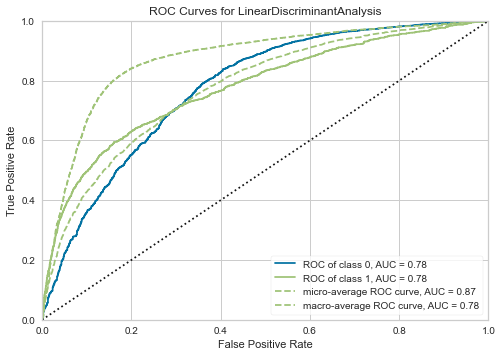

In [31]:
plot_model(tuned_lda, plot = 'auc')

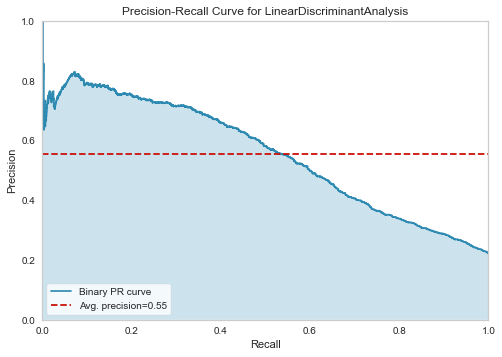

In [32]:
plot_model(tuned_lda, plot = 'pr')

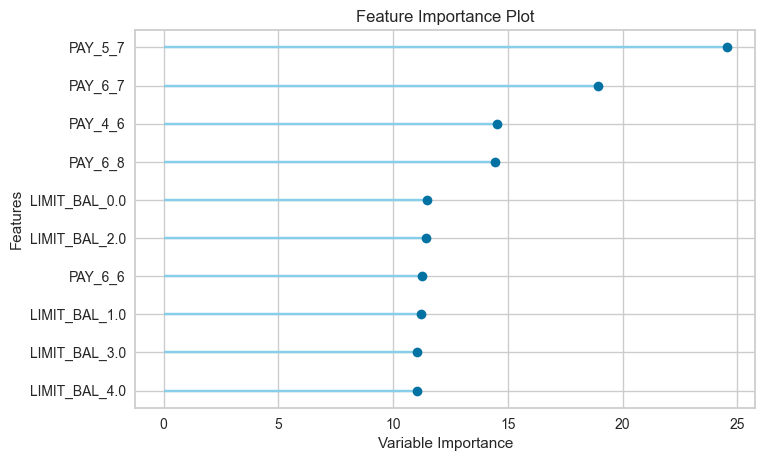

In [33]:
plot_model(tuned_lda, plot='feature')

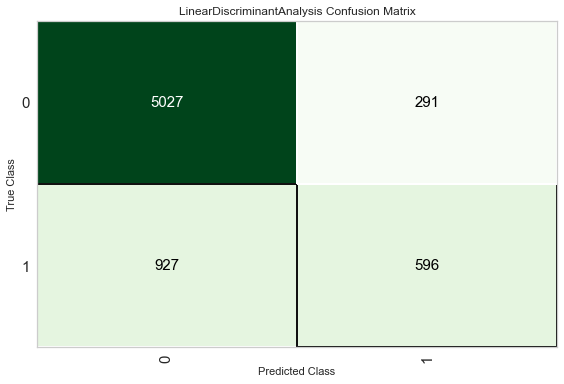

In [34]:
plot_model(tuned_lda, plot = 'confusion_matrix')

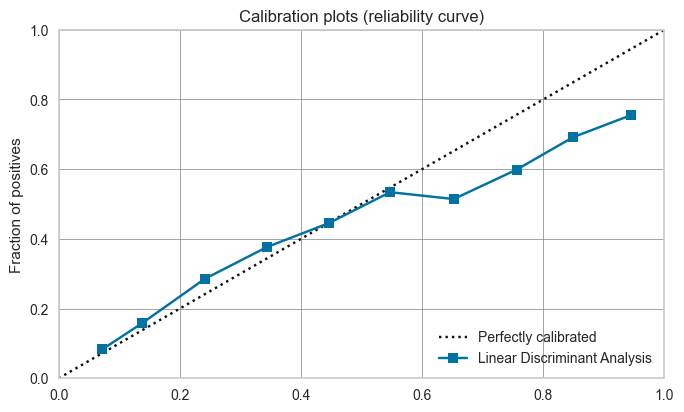

In [35]:
plot_model(tuned_lda, plot='calibration')

In [36]:
calibrated_lda = calibrate_model(tuned_lda)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8283,0.7875,0.3750,0.7097,0.4907,0.3991,0.4285
1,0.8177,0.7700,0.3551,0.6614,0.4621,0.3641,0.3897
2,0.8133,0.7526,0.3153,0.6607,0.4269,0.3317,0.3641
3,0.8258,0.7834,0.3580,0.7079,0.4755,0.3843,0.4164
4,0.8289,0.7909,0.3835,0.7068,0.4972,0.4049,0.4324
5,0.8221,0.7737,0.3352,0.7024,0.4538,0.3631,0.3986
6,0.8133,0.7485,0.2898,0.6800,0.4064,0.3163,0.3569
7,0.8221,0.7761,0.3835,0.6683,0.4874,0.3891,0.4111
8,0.8221,0.7835,0.3295,0.7073,0.4496,0.3599,0.3973
9,0.8251,0.7603,0.3409,0.7186,0.4624,0.3734,0.4106


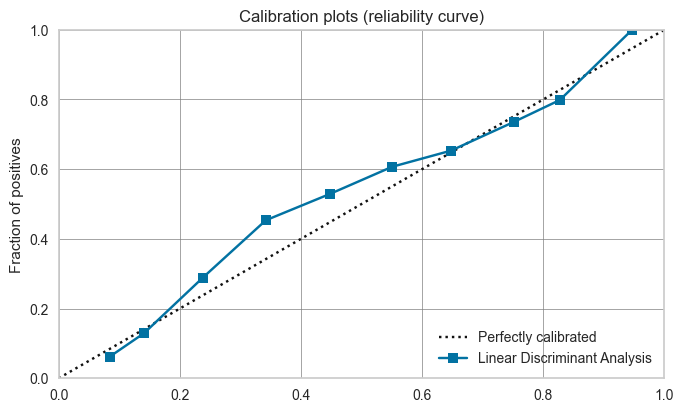

In [38]:
plot_model(calibrated_lda, plot='calibration')

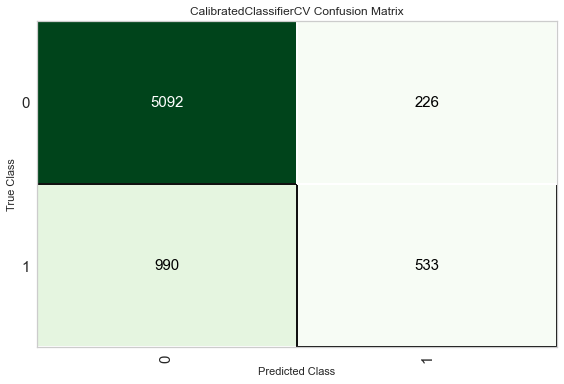

In [37]:
plot_model(calibrated_lda, plot = 'confusion_matrix')

In [ ]:

# to start the MLFlow server from notebook:
!mlflow ui

[2021-07-15 11:17:05 -0500] [98221] [INFO] Starting gunicorn 20.1.0
[2021-07-15 11:17:05 -0500] [98221] [INFO] Listening at: http://127.0.0.1:5000 (98221)
[2021-07-15 11:17:05 -0500] [98221] [INFO] Using worker: sync
[2021-07-15 11:17:05 -0500] [98224] [INFO] Booting worker with pid: 98224
[2021-07-15 11:32:03 -0500] [98221] [CRITICAL] WORKER TIMEOUT (pid:98224)
[2021-07-15 11:32:03 -0500] [98224] [INFO] Worker exiting (pid: 98224)
[2021-07-15 11:32:04 -0500] [98318] [INFO] Booting worker with pid: 98318
[2021-07-15 11:42:27 -0500] [98221] [CRITICAL] WORKER TIMEOUT (pid:98318)
[2021-07-15 11:42:27 -0500] [98318] [INFO] Worker exiting (pid: 98318)
[2021-07-15 11:42:27 -0500] [98332] [INFO] Booting worker with pid: 98332
[2021-07-15 11:53:10 -0500] [98221] [CRITICAL] WORKER TIMEOUT (pid:98332)
[2021-07-15 11:53:10 -0500] [98332] [INFO] Worker exiting (pid: 98332)
[2021-07-15 11:53:10 -0500] [98338] [INFO] Booting worker with pid: 98338
[2021-07-15 13:02:57 -0500] [98221] [CRITICAL] WORKE

In [ ]:
catboost = create_model('catboost', fold = 5, round = 2)